In [3]:
from astropy.io import fits
from astropy.io.fits import getdata, getheader
from astropy.table import Table
import glob
import cv2
import numpy as np
from astropy.visualization import ZScaleInterval
import torch

zscl = ZScaleInterval(nsamples=int(1e3), contrast=0.3, 
                      max_reject=0.5, min_npixels=5, krej=2.5, max_iterations=10)

In [4]:
%pylab
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.colors as colors
from matplotlib import rcParams
rcParams["font.size"] = 14

Using matplotlib backend: agg
Populating the interactive namespace from numpy and matplotlib


In [48]:
crs_nme = "/data/jdli/C3/MSC_0000500/MSC_CRS_210529060000_100000500_06_raw.fits"

crs = getdata(crs_nme)
# print(crs)
raw_nme = "/data/jdli/C3/MSC_0000500/MSC_MS_210529060000_100000500_06_raw.fits"
raw  = getdata(raw_nme)
head = getheader(raw_nme)
xpixscl, ypixscl = head['PIXSCAL1'], head['PIXSCAL2']


cat_name = "/data/jdli/C3/MSC_0000500/MSC_210525120000_0000500_06.cat"
cat = Table.read(cat_name, format='ascii').to_pandas()

# Step 1: Cosmic Ray Mask

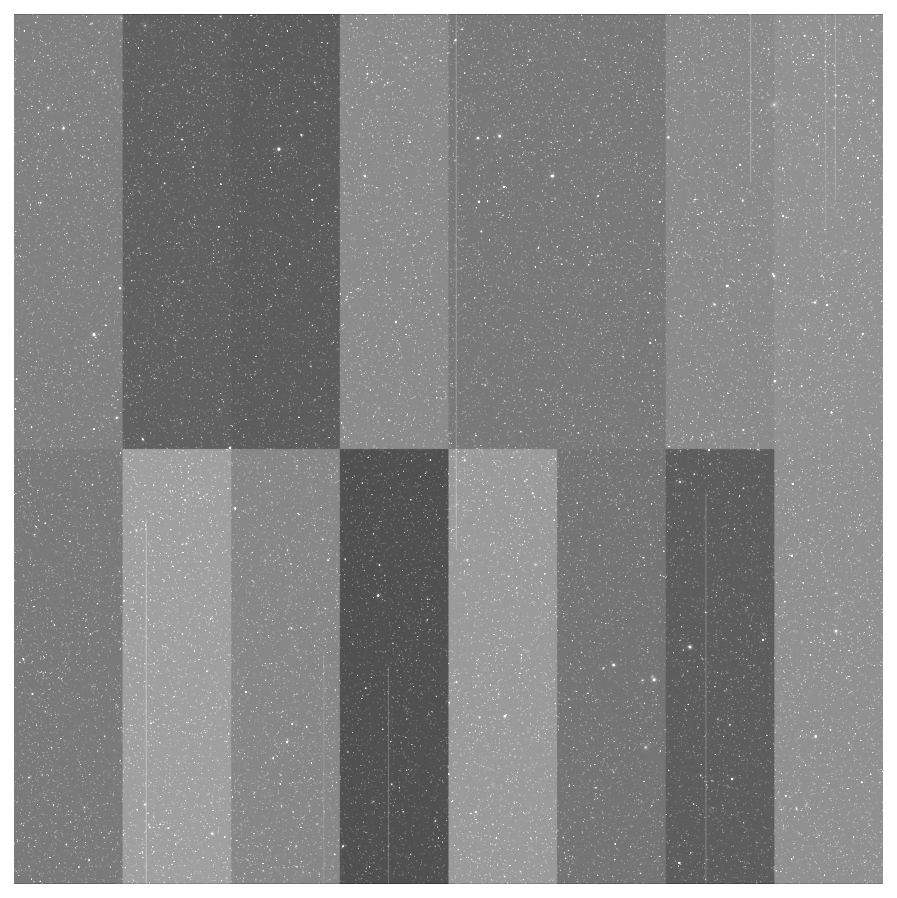

In [9]:
# show raw data
fig, ax = plt.subplots(1,1, figsize=(8,8))
vmin, vmax = zscl.get_limits(raw)

ax.imshow(raw, vmin=vmin, vmax=vmax, cmap='gray')
ax.set_axis_off()


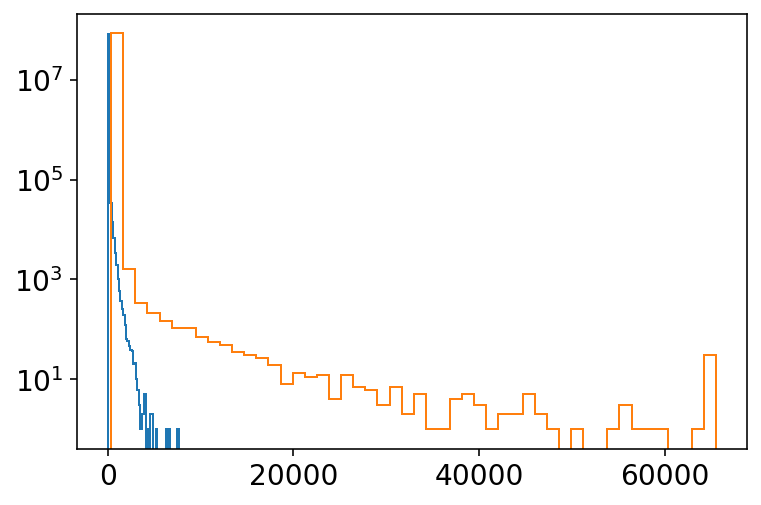

In [10]:
plt.hist((crs).flatten(), histtype="step", bins=50);
plt.hist((raw).flatten(), histtype="step", bins=50);
plt.yscale('log')

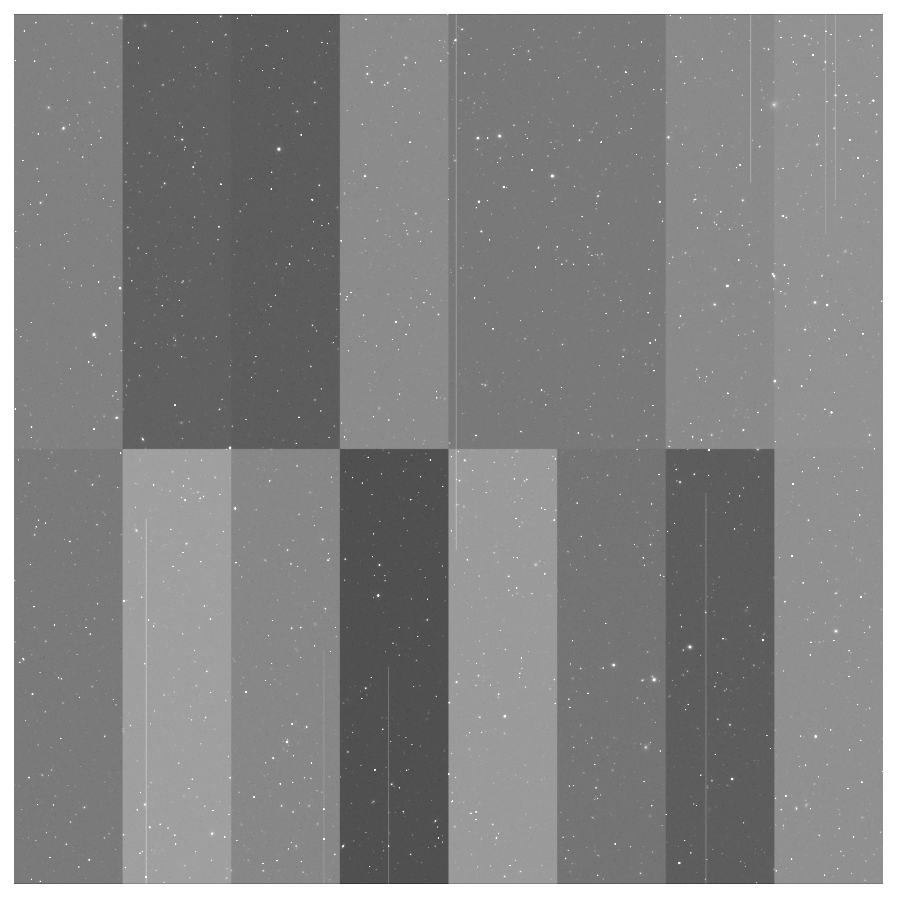

In [11]:
raw1 = raw - crs
fig, ax = plt.subplots(1,1,figsize=(8,8))

vmin, vmax = zscl.get_limits(raw1)

ax.imshow(raw1, vmin=vmin, vmax=vmax, cmap='gray')
ax.set_axis_off()

# Step 2: Split Raw

25.399

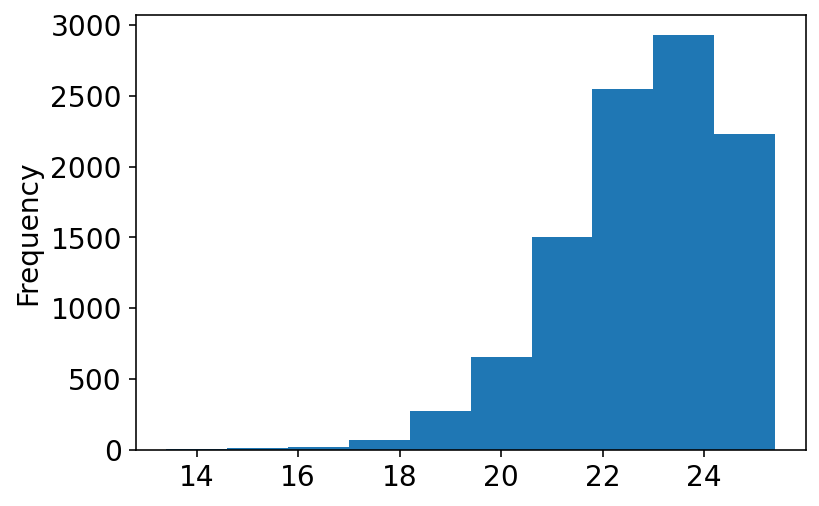

In [30]:
cat_name = "/data/jdli/C3/MSC_0000500/MSC_210525120000_0000500_06.cat"
cat = Table.read(cat_name, format='ascii').to_pandas()
cat['mag'].plot(kind='hist')
cat['mag'].max()

In [94]:
mag_lmt = 24

ind = (cat['mag']<mag_lmt)
cat = cat[ind]

xc, yc = cat['xImage'].values, cat['yImage'].values


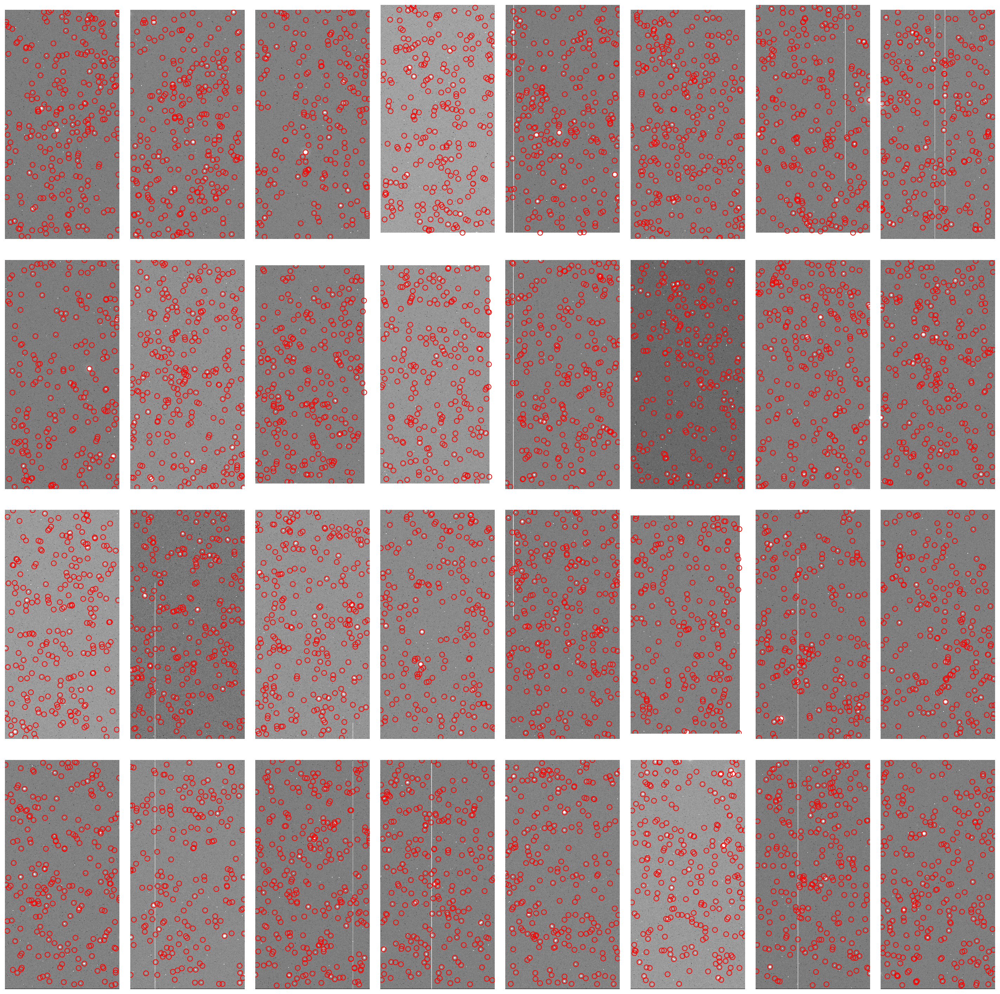

In [95]:
num_xsplit, num_ysplit = 4, 8
height, width = raw.shape[0], raw.shape[1]

x1, y1 = 0, 0
M = height//num_xsplit
N = width//num_ysplit


fig, axs = plt.subplots(num_xsplit, num_ysplit, figsize=(20,20))

for i,y in enumerate(range(0,height,M)):
    for j,x in enumerate(range(0,width,N)):
        ax = axs[i,j]
        tiles = raw1[y:y+M, x:x+N]
        ind_sub = (xc>=x) & (xc<x+N) & (yc>=y) & (yc<y+M)
        
        ximg, yimg = xc[ind_sub]-x, yc[ind_sub]-y
        vmin, vmax = zscl.get_limits(tiles)
        
        ax.imshow(tiles, vmin=vmin, vmax=vmax, cmap='gray')
        ax.set_axis_off()
        ax.scatter(ximg, yimg, s=50, facecolors='none', edgecolors='r')
        
        
plt.tight_layout()

# Step 3: Box-Size

In [96]:
cat_name = "/data/jdli/C3/MSC_0000500/MSC_210525120000_0000500_06.cat"
cat = Table.read(cat_name, format='ascii').to_pandas()
ind = (cat['mag']<mag_lmt)
cat = cat[ind]

# xc, yc = cat['xImage'].values, cat['yImage'].values

# ind_gal  = cat[ind_sub]['flag']==0
# ind_star = cat[ind_sub]['flag']==1

In [97]:
box_thrsd = 10
times_hlr = 3

xlen, ylen = cat[ind_sub]['hlr_disk']*times_hlr/xpixscl, cat[ind_sub]['hlr_disk']*times_hlr/ypixscl
xlen[xlen<box_thrsd] = box_thrsd; ylen[ylen<box_thrsd]  = box_thrsd

(array([198.,  19.,  11.,   8.,   1.,   3.,   3.,   0.,   2.,   1.]),
 array([10.        , 14.04932432, 18.09864865, 22.14797297, 26.1972973 ,
        30.24662162, 34.29594595, 38.34527027, 42.39459459, 46.44391892,
        50.49324324]),
 <BarContainer object of 10 artists>)

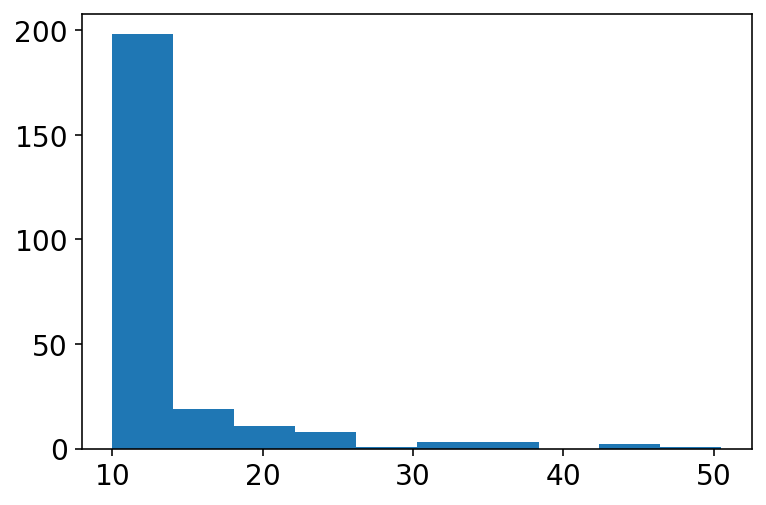

In [98]:
plt.hist(xlen)

In [99]:
def scale_box(x, lim):
    x[x<0]   = 0
    x[x>lim] = lim
    return x

x1 = scale_box(ximg-xlen,N) ; x2 = scale_box(ximg+xlen,N)
y1 = scale_box(yimg-ylen,M);  y2 = scale_box(yimg+ylen,M)
boxes = np.c_[x1, y1, x2, y2]

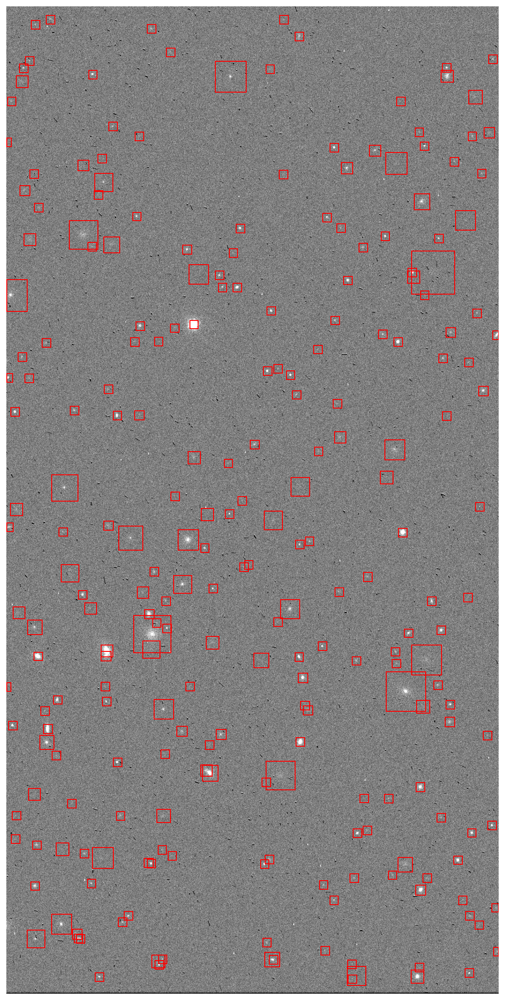

In [100]:
fig, ax = plt.subplots(1,1, figsize=(15, 20))
ax.imshow(tiles, vmin=vmin, vmax=vmax, cmap='gray')
ax.set_axis_off()
# ax.scatter(ximg, yimg, s=50, facecolors='none', edgecolors='r')

for box in boxes:
    ax.add_patch(
        Rectangle(
            (box[0], box[1]), box[2]-box[0], box[3]-box[1],
            edgecolor='red',facecolor='none', lw=1
            )
        )

# Data Reduction Pipeline

In [11]:
from tqdm import tqdm
import pandas as pd


def read_fits(fits_name):
    raw = getdata(fits_name, memmap=False)
    return raw

def read_crs(crs_name):
    return getdata(crs_name)

def get_pixscl(fits_name):
    head = getheader(fits_name)
    return head['PIXSCAL1'], head['PIXSCAL2']

def scale_box(x, lim):
    x[x<0]   = 0
    x[x>lim] = lim
    return x
    

def minmaxNormalization(raw, zscale):
    vmin, vmax = zscale.get_limits(raw)
    raw[raw<vmin] = vmin
    raw[raw>vmax] = vmax
    return (raw - vmin) / (vmax - vmin)

def extract_boxes(cat_name, mag_deep=21,):
    
    cat = Table.read(cat_name, format='ascii').to_pandas()
    ind = (cat['mag']<mag_deep)
    cat = cat[ind]
    labels = np.array(cat['flag'].values, dtype=np.uint8)
    labels[labels==2] = 1
    mags   = np.array(cat['mag'].values)
    xc, yc = cat['xImage'].values, cat['yImage'].values
    hlr_disc = cat['hlr_disk'].values
    
    return pd.DataFrame({'labels':labels, 'mag':mags, 'x':xc, 'y':yc, 'hlr':hlr_disc})

def split_raws(raw_name, crs_name, cat_name, zscale, 
               img_dir='./test_img/', tgt_dir='./test_tgt', 
               save_img=True,
               mag_deep=23, xsplit=4, ysplit=4, 
               box_thrsd=10, times_hlr=3):
    """
    from C3 raw data to crop image with specify target box
    target boxsize = times_hlr * half-light disk radius
    """
    
    raw = read_fits(raw_name)
    xpixscl, ypixscl = get_pixscl(raw_name)
    crs = read_crs(crs_name)
    raw = raw - crs
    
    cat = extract_boxes(cat_name, mag_deep=mag_deep)
    
    height, width = raw.shape[0], raw.shape[1]
    x1, y1 = 0, 0
    M = height//xsplit
    N = width//ysplit
    xc, yc = np.array(cat['x']), np.array(cat['y'])
    
    i = 0
    for y in range(0,height,M):
        for x in range(0,width,N):
            if save_img:
                tile = raw[y:y+M, x:x+N]
                img  = minmaxNormalization(tile, zscale)
                out_name = img_dir + "chip%d.fits"%(i)
                hdu = fits.PrimaryHDU(img)
                hdu.writeto(out_name, overwrite=True)
            
            ind_sub = (xc>x) & (xc<x+N) & (yc>y) & (yc<y+M)
            ximg, yimg = xc[ind_sub]-x, yc[ind_sub]-y
            
            # Create target box
            xlen = cat[ind_sub]['hlr']*times_hlr/xpixscl
            ylen = cat[ind_sub]['hlr']*times_hlr/ypixscl
            xlen[xlen<box_thrsd]  = box_thrsd
            ylen[ylen<box_thrsd]  = box_thrsd
            
            x1 = scale_box(ximg-xlen,N) ; x2 = scale_box(ximg+xlen,N)
            y1 = scale_box(yimg-ylen,M);  y2 = scale_box(yimg+ylen,M)
            boxes = np.c_[x1, y1, x2, y2]
            
            target = {'box':boxes, 'labels':cat['labels'][ind_sub], 'mag':cat['mag'][ind_sub]}
            np.save(tgt_dir + "chip%d.npy"%(i), target)
            i+=1
    return

## Make Training Set

In [9]:

root_dir = "/data/share/C3mulImg/multipleBandsImaging/CSST_shearOFF/MSC_00005*"

raw_lst_1 = glob.glob(root_dir+'/MSC_MS*_08_raw.fits')
raw_lst_2 = glob.glob(root_dir+'/MSC_MS*_23_raw.fits')
raw_lst   = (raw_lst_1+raw_lst_2); raw_lst.sort()

crs_lst_1 = glob.glob(root_dir+'/MSC_CRS*_08_raw.fits')
crs_lst_2 = glob.glob(root_dir+'/MSC_CRS*_23_raw.fits')
crs_lst   = (crs_lst_1+crs_lst_2); crs_lst.sort()


cat_lst_1 = glob.glob(root_dir+'/MSC_*08.cat')
cat_lst_2 = glob.glob(root_dir+'/MSC_*23.cat')
cat_lst   = (cat_lst_1+cat_lst_2); cat_lst.sort()

print(len(raw_lst), len(crs_lst), len(cat_lst))


76 76 76


In [113]:
for k in tqdm(range(len(raw_lst))):
    raw_name = raw_lst[k]
    cat_name = cat_lst[k]
    crs_name = crs_lst[k]

    xpixscl, ypixscl = get_pixscl(raw_name)
    split_raws(
        raw_name, crs_name, cat_name, zscl, 
        img_dir='/data/jdli/C3train/img/img%d'%k, 
        tgt_dir='/data/jdli/C3train/target/tgt%d'%k,
        mag_deep=24, 
        xsplit=4, ysplit=8, box_thrsd=10, 
        times_hlr=3
    )

100%|█████████████████████████████████████████| 76/76 [04:49<00:00,  3.81s/it]


In [12]:
for k in tqdm(range(len(raw_lst))):
    raw_name = raw_lst[k]
    cat_name = cat_lst[k]
    crs_name = crs_lst[k]

    xpixscl, ypixscl = get_pixscl(raw_name)
    split_raws(
        raw_name, crs_name, cat_name, zscl, 
        img_dir='/data/jdli/C3train/img/img%d'%k, 
        tgt_dir='/data/jdli/C3train/target20/tgt%d'%k,
        mag_deep=20, save_img=False,
        xsplit=4, ysplit=8, box_thrsd=10, 
        times_hlr=3
    )

100%|██████████████████████████████████| 76/76 [01:54<00:00,  1.51s/it]


In [13]:
for k in tqdm(range(len(raw_lst))):
    raw_name = raw_lst[k]
    cat_name = cat_lst[k]
    crs_name = crs_lst[k]

    xpixscl, ypixscl = get_pixscl(raw_name)
    split_raws(
        raw_name, crs_name, cat_name, zscl, 
        img_dir='/data/jdli/C3train/img/img%d'%k, 
        tgt_dir='/data/jdli/C3train/target22/tgt%d'%k,
        mag_deep=22, save_img=False,
        xsplit=4, ysplit=8, box_thrsd=10, 
        times_hlr=3
    )

100%|██████████████████████████████████| 76/76 [01:19<00:00,  1.04s/it]


## Make Test Set

In [14]:
root_dir = "/data/share/C3mulImg/multipleBandsImaging/CSST_shearOFF/MSC_000049*"

raw_lst_1 = glob.glob(root_dir+'/MSC_MS*_08_raw.fits')
raw_lst_2 = glob.glob(root_dir+'/MSC_MS*_23_raw.fits')
raw_lst   = (raw_lst_1+raw_lst_2); raw_lst.sort()

crs_lst_1 = glob.glob(root_dir+'/MSC_CRS*_08_raw.fits')
crs_lst_2 = glob.glob(root_dir+'/MSC_CRS*_23_raw.fits')
crs_lst   = (crs_lst_1+crs_lst_2); crs_lst.sort()


cat_lst_1 = glob.glob(root_dir+'/MSC_*08.cat')
cat_lst_2 = glob.glob(root_dir+'/MSC_*23.cat')
cat_lst   = (cat_lst_1+cat_lst_2); cat_lst.sort()

print(len(raw_lst), len(crs_lst), len(cat_lst))

20 20 20


In [115]:
for k in tqdm(range(len(raw_lst))):
    raw_name = raw_lst[k]
    cat_name = cat_lst[k]
    crs_name = crs_lst[k]

    xpixscl, ypixscl = get_pixscl(raw_name)
    split_raws(
        raw_name, crs_name, cat_name, zscl, 
        img_dir='/data/jdli/C3test/img/img%d'%k, 
        tgt_dir='/data/jdli/C3test/target/tgt%d'%k,
        mag_deep=24, 
        xsplit=4, ysplit=8, box_thrsd=10, 
        times_hlr=3
    )

100%|█████████████████████████████████████████| 20/20 [01:14<00:00,  3.72s/it]


In [15]:
for k in tqdm(range(len(raw_lst))):
    raw_name = raw_lst[k]
    cat_name = cat_lst[k]
    crs_name = crs_lst[k]

    xpixscl, ypixscl = get_pixscl(raw_name)
    split_raws(
        raw_name, crs_name, cat_name, zscl, 
        img_dir='/data/jdli/C3test/img/img%d'%k, 
        tgt_dir='/data/jdli/C3test/target20/tgt%d'%k,
        mag_deep=20, save_img=False,
        xsplit=4, ysplit=8, box_thrsd=10, 
        times_hlr=3
    )

100%|██████████████████████████████████| 20/20 [00:30<00:00,  1.53s/it]


In [16]:
for k in tqdm(range(len(raw_lst))):
    raw_name = raw_lst[k]
    cat_name = cat_lst[k]
    crs_name = crs_lst[k]

    xpixscl, ypixscl = get_pixscl(raw_name)
    split_raws(
        raw_name, crs_name, cat_name, zscl, 
        img_dir='/data/jdli/C3test/img/img%d'%k, 
        tgt_dir='/data/jdli/C3test/target22/tgt%d'%k,
        mag_deep=22, save_img=False,
        xsplit=4, ysplit=8, box_thrsd=10, 
        times_hlr=3
    )

100%|██████████████████████████████████| 20/20 [00:20<00:00,  1.04s/it]
